# Dynamic communities in stock market network

This Jupyter notebook presents an example of community detection in dynamic networks.

The network is constructed by calculating correlation between log-returns in a time window, `window_size` for a number of `num_rolls` time periods. Then the links betwen two tickers (nodes in the network) are created if a value of correlation exceeds a threshold value of `thresh`. 

In [16]:
import pandas as pd
import swat
from collections import defaultdict
import time
import swat.cas.datamsghandlers as dmh
import math
import os
import matplotlib.pyplot as plt
%matplotlib inline
import networkx as nx
from random import random
from IPython.display import Image

In [14]:
r_df = pd.read_csv("sp500hist.csv",index_col=0)

In [79]:
cashost = "your host"
casport = 12345

In [21]:
s1 = swat.CAS(cashost,casport)

In [22]:
s1.loadactionset('networkSocial')
s1.loadactionset(actionset="simple")
s1.loadactionset(actionset="optNetwork")

NOTE: Added action set 'networkSocial'.
NOTE: Added action set 'simple'.
NOTE: Added action set 'optNetwork'.


[actionset]

 'optNetwork'

+ Elapsed: 0.374s, user: 0.655s, sys: 0.696s, mem: 36.9mb

In [26]:
num_tickers = 497 # 497
short_list = r_df.columns.values[:num_tickers]
comm_colors = [(random(), random(), random()) for _i in range(num_tickers)]

In [56]:
def draw_communities(date,node_list,comm_colors, comm_nodes): 
    G=nx.Graph()
    G.add_nodes_from(node_list)
    for i,row in links_df.iterrows():
        G.add_edge(row['from'],row['to'], weight=row['weight'])

    communities = defaultdict(list)

    for node in node_list:
        comm_id = comm_nodes[node]
        communities[comm_id].append(node)
        
    node_colors = []
    
    for node in G.nodes():
        if node in comm_nodes:
            comm_id = comm_nodes[node]
            
            if len(communities[comm_id]) > 1:
                node_colors.append(comm_colors[comm_id])
            else:
                node_colors.append((1,1,1))
        else:
            node_colors.append((random(),random(),random()))

    edge_colors = []
    for u,v in G.edges():
        if u in comm_nodes and v in comm_nodes:
            if comm_nodes[u] == comm_nodes[v]:
                edge_colors.append(comm_colors[comm_nodes[u]])
            else:
                edge_colors.append((1,1,1))

    labels = {}
    print(len(G.nodes()))
    for i in G.nodes():
        labels[i] = short_list[i]

    x_step = 2.
    y_step = 2.
    x_max = 25
    comm_space= 0.1


    x = 0
    y = 0
    pos = {}
    
    for node in node_list:
        pos[node] = (x,y)
        x += x_step
        if x > x_max:
            x = 0
            y += y_step


    fig = plt.figure(figsize=(20,20),dpi=200)
    nx.draw_networkx(G, pos, node_color = node_colors,labels=labels, 
                     edge_color = edge_colors, node_size = 500)

    #plt.show()
    fig.savefig("sp500comms_square_comm"+date+".png",bbox_inches='tight')
    plt.close()

In [59]:
window_size = 30 # defines the rolling correlation window (30 days, 100 days, etc.)
start_day = 3315 # 2008-07-03 is 3400 in this dataset
num_rolls = 160 # defines number of days in tracking

num_communities = [] # a list for plotting number of communities at each day
modularities = [] # a list for plotting the modularity values for communities at each day
stepped_index = [] 
number_of_links = []
membership_track = defaultdict(list)
mean_track = defaultdict(list)
# The graph is defined by creating a link if rolling correlation coefficient between two
# symbols is greater than a threshold (thresh). thresh varies between -1 to 1. 
# Low values of thresh will produce fully connected graph and all symbols interconnected. 
# High values of thresh will produce an almosted disconnected set of nodes or very large number of singletons
thresh = 0.8
# assuming the number of days between start and end is larger than window

data_index = r_df.index
max_comm_size = []
comm_current = defaultdict(set)
comm_previous = defaultdict(set)

# compares the community assignment between different time steps. 
# the input arguments are dictionaries, with community ids as keys, and sets of node ids as values
# the match is made by creation of bipartite graph with communities as nodes and weighted links between communities
# from different time steps. The wieghts are defined 1 - the ratio of intersection size of a set of nodes in one community
# and another community from another timestemp and the union size of these two sets. If the weight is 0 it means that the
# these communities are the same in two different time steps.


start_time = time.time()

# main rolling loop for each day
for cday in range(start_day,start_day+num_rolls):
    print("progress: {} %".format((float(cday-start_day)/num_rolls) * 100))
    current_time = time.time()
    time_passed = current_time-start_time
    ratio = (float(cday-start_day)/num_rolls)
    if ratio:
        total_time = time_passed/ratio
        remaining_time = total_time-time_passed
        print ("Take a breake for the next {} mins".format(remaining_time/60))
    
    if(comm_current):
        comm_previous = comm_current
    
    # slice data
    stepped_index.append(data_index[cday+window_size])
    small_data = r_df[short_list][cday:cday+window_size]

    data = small_data
    handler = dmh.PandasDataFrame(data)
    s1.addtable(table='rawdata', **handler.args.addtable, replace=True)
    res = s1.simple.correlation(table={"name":"rawdata"})
    

    corr_df = res['Correlation']
    from_list = []
    to_list = []
    node_list = []

    short_list=list(short_list)
    for i,row in corr_df.iterrows():
        node_list.append(i)
        for s in short_list:

            if(not math.isnan(row[s])):
                if row[s]>thresh and i != short_list.index(s):
                    #print(row[s])
                    #print(i,short_list.index(s))
                    from_list.append(i)
                    to_list.append(short_list.index(s))
    links_df = pd.DataFrame({'from':from_list, 'to':to_list})
    number_of_links.append(links_df.shape[0])
    links_df['weight']=1

    nodes_df = pd.DataFrame({'node':node_list})

    
    links_df.to_csv("links.csv")
    nodes_df.to_csv("nodes.csv")
    s1.read_csv("links.csv", casout=dict(name="links_df", replace=True))
    s1.read_csv("nodes.csv", casout=dict(name="nodes_df", replace=True))
    
    
    # community detection step
    s1.community(links="links_df",nodes="nodes_df",
             algorithm="parallelLabelProp",
#             algorithm="louvain",
             direction="directed",
             outCommunity={"name":"community", "replace":True},
             outNodes={"name":"labnodes", "replace":True},
            outLevel={"name":"outlevel", "replace":True},
            randomSeed=33333,
            tolerance = 0.00001,
            resolutionList={0.01}
        )
    
    result = s1.table.tableInfo(table="community")
    numRows = result["TableInfo"]['Rows'][0]
    comm_df = (s1.fetch('community', maxRows=numRows, to=numRows))['Fetch']

    result = s1.table.tableInfo(table="outlevel")
    numRows = result["TableInfo"]['Rows'][0]
    level_df = (s1.fetch('outlevel', maxRows=numRows, to=numRows))['Fetch']
    
    num_comms = int(level_df['communities'][0])
    print(num_comms)
    
    modularity = float(level_df['modularity'])
    print(modularity)
    
    num_communities.append(num_comms)
    modularities.append(modularity)
    
    result = s1.table.tableInfo(table="labnodes")
    numRows = result["TableInfo"]['Rows'][0]
    nodes_pd = (s1.fetch('labnodes', maxRows=numRows, to=numRows))['Fetch']
    
    #sort by community size
    comm_sizes = comm_df.sort_values(['nodes'], ascending=[False])
    sorted_comms = [int(x) for x in comm_sizes['community']]
    max_comm_size.append(int(comm_df['nodes'][sorted_comms[0]]))
    
    
    comm_current=defaultdict(set)
    for i,row in nodes_pd.iterrows():
        node = int(row['node'])
        comm_id = int(row['community_0'])
        comm_nodes[node]=comm_id
        comm_current[comm_id].add(node)
 
    # reassign community ids in comm_nodes for tracking
    if(comm_previous):
        similarity,matching = compare_communities(comm_previous, comm_current)
        #print("matching")
        #print(len(matching))
        revmatching={}
        for k in matching.keys():
            revmatching[matching[k]] = k
        max_match = max(matching.values())
        print(max_match, " is maximum comm id")
        for i in comm_nodes.keys():
            if comm_nodes[i] in revmatching:
                #print("new comm id ", comm_nodes[i])
               # new_set = set(comm_current[comm_nodes[i]])
                comm_nodes[i]=revmatching[comm_nodes[i]]
               # print("old comm id ",comm_nodes[i])
               # old_set = set(comm_previous[comm_nodes[i]])
                #print("inetersection ", (new_set & old_set))
            else:
                #print(comm_nodes[i]," is not in matching")
                revmatching[comm_nodes[i]] = max_match+1
                max_match += 1
                comm_nodes[i]=revmatching[comm_nodes[i]]
         
    draw_communities(data_index[cday+window_size], node_list, comm_colors, comm_nodes)
 

progress: 0.0 %
NOTE: Cloud Analytic Services made the uploaded file available as table LINKS_DF in caslib CASUSERHDFS(foo).
NOTE: The table LINKS_DF has been created in caslib CASUSERHDFS(foo) from binary data uploaded to Cloud Analytic Services.
NOTE: Cloud Analytic Services made the uploaded file available as table NODES_DF in caslib CASUSERHDFS(foo).
NOTE: The table NODES_DF has been created in caslib CASUSERHDFS(foo) from binary data uploaded to Cloud Analytic Services.
NOTE: The number of nodes in the input graph is 496.
NOTE: The number of links in the input graph is 4234.
NOTE: Processing community detection using 5496 threads across 134 machines.
NOTE: At resolution=0.01, the community algorithm found 206 communities with modularity=0.433427.
NOTE: Input table partition used 0.14 seconds.
NOTE: Processing community detection used 1.15 (cpu: 5.64) seconds.
206
0.43342733063360694
496
progress: 0.625 %
Take a break for the next 35.91013451814651 mins
...

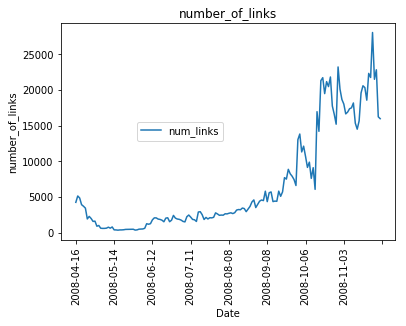

In [76]:
mod_df = pd.DataFrame(number_of_links, columns=['num_links'], index = stepped_index)
mod_df.plot(legend=False)
plt.legend(loc='center right', bbox_to_anchor = (0.5, 0.5))
plt.title("number_of_links")
plt.xlabel("Date")
plt.xticks(rotation='vertical')
plt.ylabel("number_of_links")
plt.show()
plt.close()

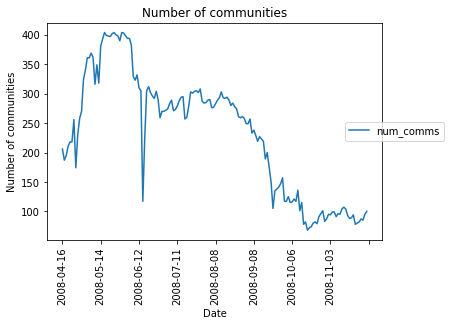

In [78]:
num_comm_df = pd.DataFrame(num_communities, columns=['num_comms'], index = stepped_index)
num_comm_df.plot(legend=False)
plt.legend(loc='center right', bbox_to_anchor = (1.2, 0.5))
plt.title("Number of communities")
plt.xlabel("Date")
plt.xticks(rotation='vertical')
plt.ylabel("Number of communities")
plt.show()
plt.close()

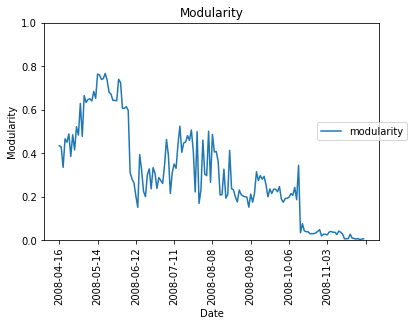

In [70]:
mod_df = pd.DataFrame(modularities, columns=['modularity'], index = stepped_index)
mod_df.plot(legend=False, ylim = (0,1))
plt.legend(loc='center right', bbox_to_anchor = (1.1, 0.5))
plt.title("Modularity")
plt.xlabel("Date")
plt.xticks(rotation='vertical')
plt.ylabel("Modularity")
plt.show()
plt.close()

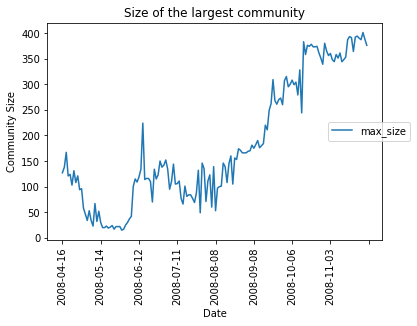

In [73]:
mod_df = pd.DataFrame(max_comm_size, columns=['max_size'], index = stepped_index)
mod_df.plot(legend=False)
plt.legend(loc='center right', bbox_to_anchor = (1.1, 0.5))
plt.title("Size of the largest community")
plt.xlabel("Date")
plt.xticks(rotation='vertical')
plt.ylabel("Community Size")
plt.show()
plt.close()

Before the market crash the are many communities with a small number of members. Here is a network for (June 24 - July 24) window. Members of a community are colored the same. The nodes with no links are colored white (background)

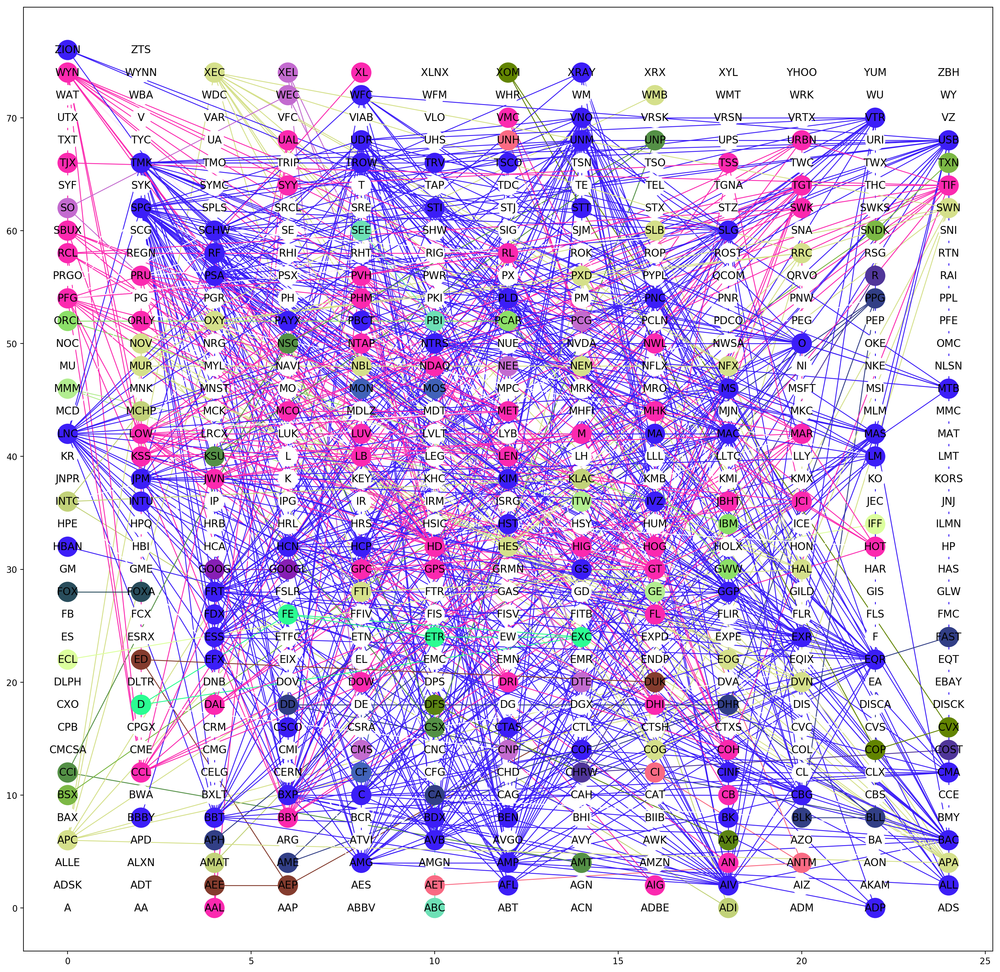

In [71]:
Image(filename='sp500comms_square_comm2008-07-24.png') 

This depicts communities in a network snapshot (August 29 - September 29). 

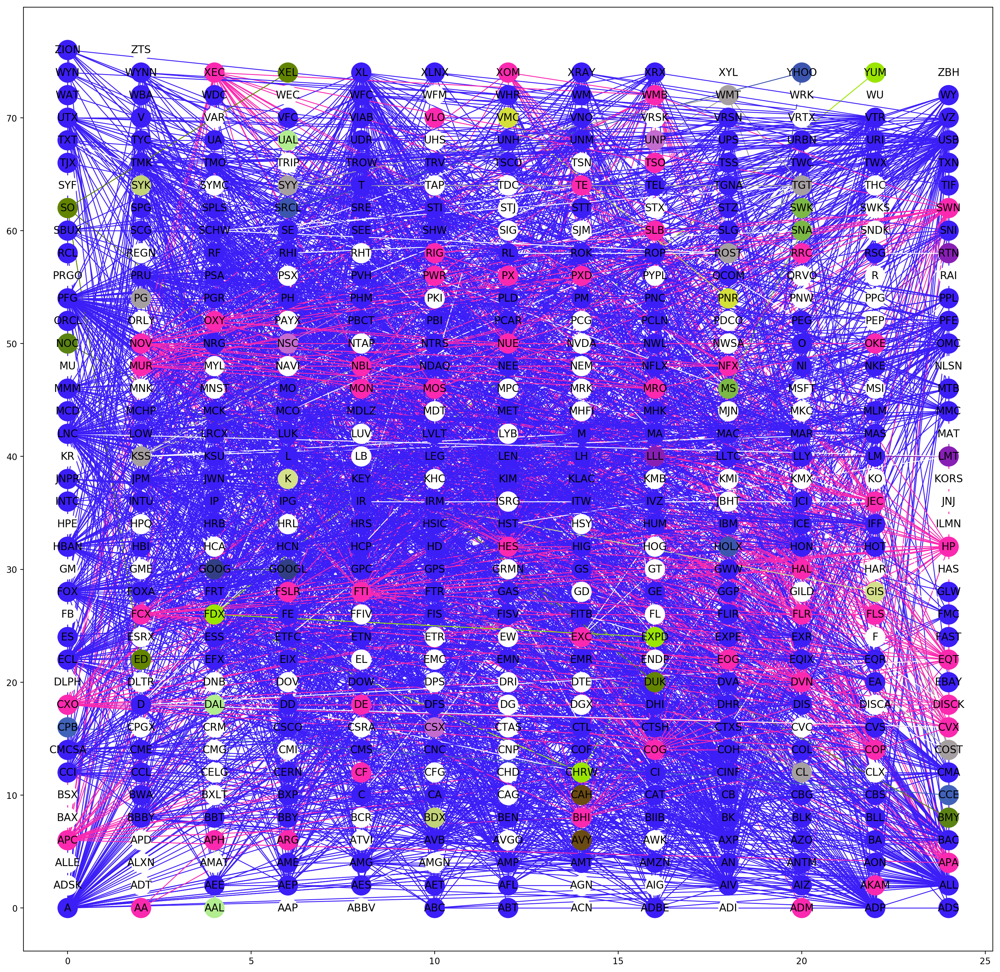

In [68]:
Image(filename='sp500comms_square_comm2008-09-29.png') 

This network shows communities (or rather one almost fully connected graph) with a window centered at September 29.

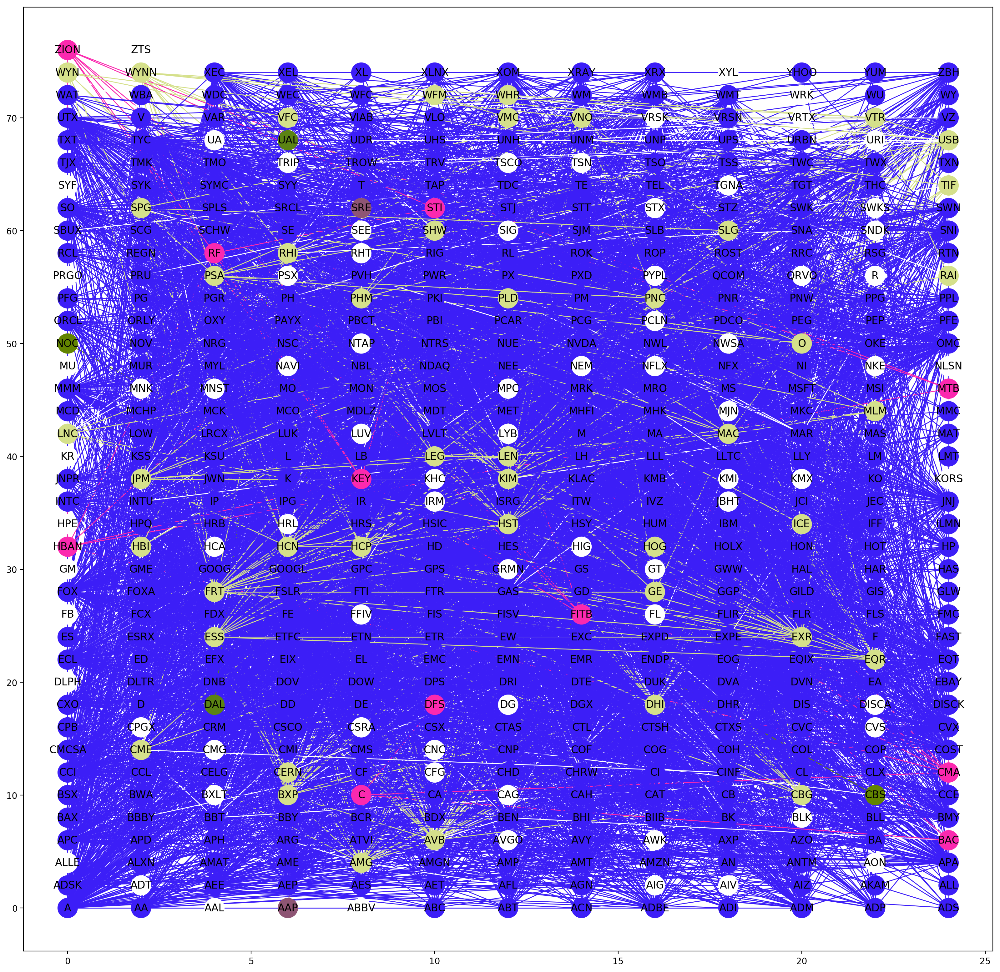

In [72]:
Image(filename='sp500comms_square_comm2008-10-15.png') 